In [1]:
# Get the Oxford Pets Dataset

!wget https://www.robots.ox.ac.uk/~vgg/data/pets/data/images.tar.gz
!wget https://www.robots.ox.ac.uk/~vgg/data/pets/data/annotations.tar.gz
!tar -xf images.tar.gz
!tar -xf annotations.tar.gz
!rm annotations.tar.gz
!rm images.tar.gz
!mkdir data/pets
!mv images data/pets
!mv annotations data/pets

In [2]:
import matplotlib.pyplot as plt
from tensorflow.keras.utils import load_img, img_to_array, array_to_img, image_dataset_from_directory
from tensorflow import keras
from tensorflow.keras import layers, activations, optimizers, losses, metrics
import tensorflow as tf
import numpy as np
import matplotlib.cm as cm 
import random
import os, shutil, pathlib
from tqdm.notebook import tqdm

In [3]:
input_dir = 'data/pets/images/'
target_dir = 'data/pets/annotations/trimaps/'

input_img_paths = sorted([os.path.join(input_dir, fname) 
                        for fname in os.listdir(input_dir) if fname.endswith('.jpg')])

target_paths = sorted([os.path.join(target_dir, fname) 
                        for fname in os.listdir(target_dir) if fname.endswith('.png') and not fname.startswith('.')])

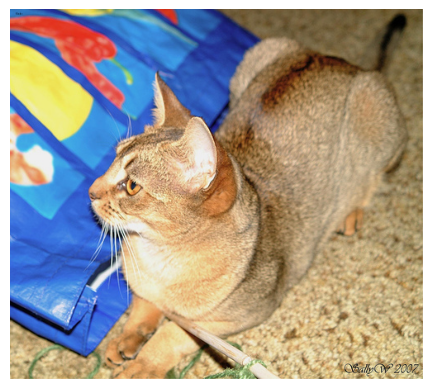

In [4]:
plt.axis('off')
plt.imshow(load_img(input_img_paths[9]))

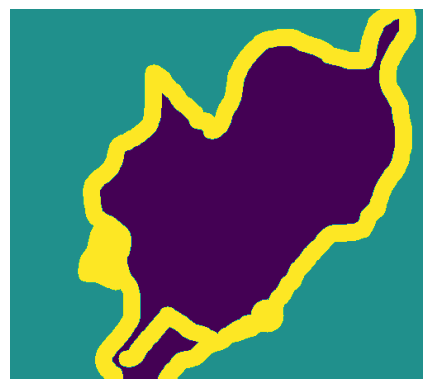

In [5]:
def display_target(target_array):
    normalized_array = (target_array.astype(np.uint8) - 1) * 127
    plt.axis('off')
    plt.imshow(normalized_array[:,:,0])

img = img_to_array(load_img(target_paths[9], color_mode='grayscale'))
display_target(img)

In [6]:
img_size = (200, 200)
num_images = len(input_img_paths)

seed = 1337
random.Random(seed).shuffle(input_img_paths)
random.Random(seed).shuffle(target_paths)

def path_to_input_image(path, img_size):
    return img_to_array(load_img(path, target_size=img_size))

def path_to_target(path, img_size):
    img = img_to_array(load_img(path, target_size=img_size, color_mode='grayscale'))
    img = img.astype(np.uint8) - 1
    return img

input_imgs = np.zeros((num_images,) + img_size + (3,), dtype=np.float32)
targets = np.zeros((num_images,) + img_size + (1,), dtype=np.uint8)

for i in range(num_images):
    input_imgs[i] = path_to_input_image(input_img_paths[i], img_size=img_size)
    targets[i] = path_to_target(target_paths[i], img_size=img_size)

num_val_samples = 1000
train_input_images = input_imgs[:-num_val_samples]
train_targets = targets[:-num_val_samples]
val_input_imgs = input_imgs[-num_val_samples:]
val_targets = targets[-num_val_samples:]

In [7]:
def get_model(img_size, num_classes):

    inputs = keras.Input(shape=img_size + (3,))  # Size + Channels
    
    x = layers.Rescaling(1./255)(inputs)
    x = layers.Conv2D(64, 3, strides=2, activation=activations.relu, padding='same')(x)
    x = layers.Conv2D(64, 3, activation=activations.relu, padding='same')(x)
    x = layers.Conv2D(128, 3, strides=2, activation=activations.relu, padding='same')(x)
    x = layers.Conv2D(128, 3, activation=activations.relu, padding='same')(x)
    x = layers.Conv2D(256, 3, strides=2, activation=activations.relu, padding='same')(x)
    x = layers.Conv2D(256, 3, activation=activations.relu, padding='same')(x)

    x = layers.Conv2DTranspose(256, 3, activation=activations.relu, padding='same')(x)
    x = layers.Conv2DTranspose(256, 3, strides=2, activation=activations.relu, padding='same')(x)
    x = layers.Conv2DTranspose(128, 3, activation=activations.relu, padding='same')(x)
    x = layers.Conv2DTranspose(128, 3, strides=2, activation=activations.relu, padding='same')(x)
    x = layers.Conv2DTranspose(64, 3, activation=activations.relu, padding='same')(x)
    x = layers.Conv2DTranspose(64, 3, strides=2, activation=activations.relu, padding='same')(x)

    outputs = layers.Conv2D(num_classes, 3, activation=activations.softmax, padding='same')(x)

    model = keras.Model(inputs, outputs)

    return model

In [8]:
model = get_model(img_size=img_size, num_classes=3)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 200, 200, 3)]     0         
                                                                 
 rescaling (Rescaling)       (None, 200, 200, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 100, 100, 64)      1792      
                                                                 
 conv2d_1 (Conv2D)           (None, 100, 100, 64)      36928     
                                                                 
 conv2d_2 (Conv2D)           (None, 50, 50, 128)       73856     
                                                                 
 conv2d_3 (Conv2D)           (None, 50, 50, 128)       147584    
                                                                 
 conv2d_4 (Conv2D)           (None, 25, 25, 256)       295168

### Note

We use striding in segmentation models as they better preserve location information per pixel. As our segmentation mask is pixel-perfect, we would not benefit from using Max/Average Pooling, where the value is the effect of all the values in the kernel, and which does not provide us with pixel-perfect location information of how that value came to be, or the specific influences of all the other values.

In [9]:
model.compile(optimizer=optimizers.RMSprop(),
              loss=losses.SparseCategoricalCrossentropy())

callbacks = [keras.callbacks.ModelCheckpoint(filepath='ckpts/oxford_segmentation.keras',
                                             save_best_only=True)]

history = model.fit(train_input_images, train_targets,
                    epochs=50,
                    callbacks=callbacks,
                    batch_size=64,
                    validation_data=(val_input_imgs, val_targets),
                    verbose=1)

Epoch 1/50


2023-10-24 10:47:12.518437: W tensorflow/tsl/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


100/100 [==============================] - 44s 427ms/step - loss: 24.3568 - val_loss: 1.1986
Epoch 2/50
100/100 [==============================] - 41s 408ms/step - loss: 0.9174 - val_loss: 0.9249
Epoch 3/50
100/100 [==============================] - 41s 408ms/step - loss: 0.8397 - val_loss: 0.8788
Epoch 4/50
100/100 [==============================] - 41s 410ms/step - loss: 0.7842 - val_loss: 0.7333
Epoch 5/50
100/100 [==============================] - 41s 409ms/step - loss: 0.7362 - val_loss: 0.6688
Epoch 6/50
100/100 [==============================] - 41s 409ms/step - loss: 0.6931 - val_loss: 0.6156
Epoch 7/50
100/100 [==============================] - 41s 409ms/step - loss: 0.6497 - val_loss: 0.6106
Epoch 8/50
100/100 [==============================] - 41s 409ms/step - loss: 0.6203 - val_loss: 0.7674
Epoch 9/50
100/100 [==============================] - 41s 408ms/step - loss: 0.5992 - val_loss: 0.6064
Epoch 10/50
100/100 [==============================] - 41s 408ms/step - loss: 0.577

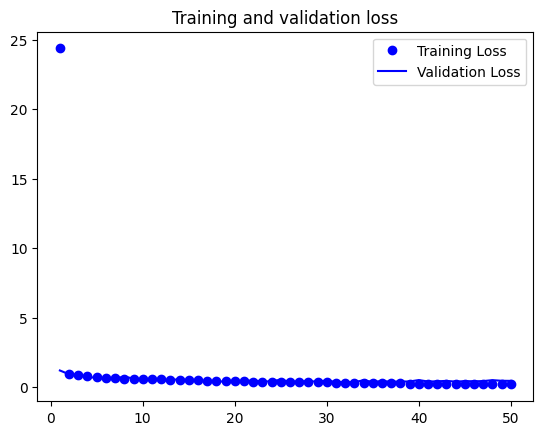

In [10]:
epochs = range(1, len(history.history['loss']) + 1)
loss = history.history['loss']
val_loss = history.history['val_loss']
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Validation Loss')
plt.title('Training and validation loss')
plt.legend()

1/1 [==============================] - 0s 162ms/step


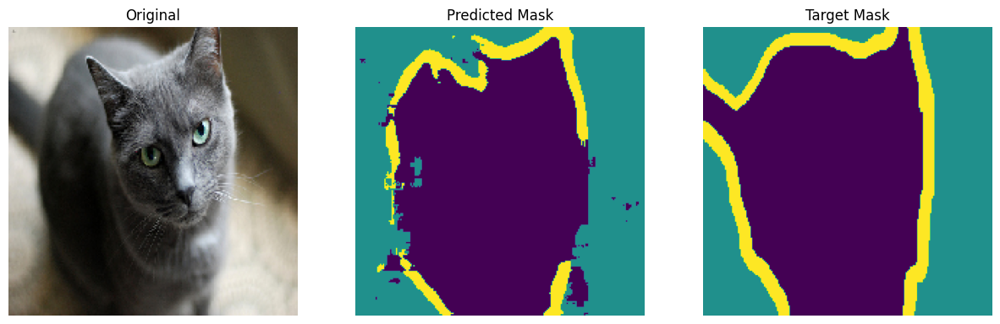

In [11]:
model = keras.models.load_model(filepath='ckpts/oxford_segmentation.keras')

fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
fig.set(figheight=5, figwidth=15)

i = 6
test_image = val_input_imgs[i]
ax1.axis('off')
ax1.set_title('Original')
ax1.imshow(array_to_img(test_image))

mask = model.predict(np.expand_dims(test_image, 0))[0]
mask = np.argmax(mask, axis=-1)
mask *= 127
ax2.set_title('Predicted Mask')
ax2.axis('off')
ax2.imshow(mask)

ax3.axis('off')
ax3.set_title('Target Mask')
ax3.imshow(val_targets[i])


## ResNets

In [12]:
# Example 1: No MaxPooling layer, so we resize residual layer using a 1x1 conv, then add elemnent wise (preserves shape)

inputs = keras.Input(shape=(32, 32, 3))
x = layers.Conv2D(32, 3, activation=activations.relu)(inputs)
print(x.shape)
residual = x 
x = layers.Conv2D(64, 3, activation=activations.relu, padding='same')(x)
print(x.shape)
residual = layers.Conv2D(64, 1)(residual)
x = layers.add([x, residual]) # Element-wise
print(x.shape)

(None, 30, 30, 32)
(None, 30, 30, 64)
(None, 30, 30, 64)


In [13]:
# Example 2: MaxPooling2D follows the original Conv, so the residual connection is strided by 2, so as to preserve spatial information better (as compared to MaxPooling it) and match the original output shape

inputs = keras.Input(shape=(32, 32, 3))
x = layers.Conv2D(32, 3, activation=activations.relu)(inputs)
print(x.shape)
residual = x 
x = layers.Conv2D(64, 3, activation=activations.relu, padding='same')(x)
x = layers.MaxPooling2D(2, padding='same')(x)
print(x.shape)
residual = layers.Conv2D(64, 1, strides=2)(residual)
x = layers.add([x, residual]) # Element-wise
print(x.shape)

(None, 30, 30, 32)
(None, 15, 15, 64)
(None, 15, 15, 64)


In [14]:
# Example 3: ConvNet structured into reusable blocks

inputs = keras.Input(shape=(32, 32, 3))
x = layers.Rescaling(1. / 255)(inputs)

def residual_block(x, filters, pooling=False):

    residual = x
    x = layers.Conv2D(filters, 3, activation=activations.relu, padding='same')(x)

    x = layers.Conv2D(filters, 3, activation=activations.relu, padding='same')(x)

    if pooling:
        x = layers.MaxPooling2D(2, padding='same')(x)
        residual = layers.Conv2D(filters, 1, strides=2)(residual)
    
    elif filters != residual.shape[-1]:
        residual = layers.Conv2D(filters, 1)(residual)
    
    x = layers.add([x, residual])

    return x

x = residual_block(x, filters=32, pooling=True)
x = residual_block(x, filters=64, pooling=True)
x = residual_block(x, filters=128, pooling=False)
x = layers.GlobalAveragePooling2D()(x)

outputs = layers.Dense(1, activation=activations.sigmoid)(x)

model = keras.Model(inputs=inputs, outputs=outputs)

model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 32, 32, 3)]  0           []                               
                                                                                                  
 rescaling_1 (Rescaling)        (None, 32, 32, 3)    0           ['input_4[0][0]']                
                                                                                                  
 conv2d_13 (Conv2D)             (None, 32, 32, 32)   896         ['rescaling_1[0][0]']            
                                                                                                  
 conv2d_14 (Conv2D)             (None, 32, 32, 32)   9248        ['conv2d_13[0][0]']              
                                                                                            

## Batch Normalization

In [15]:
# Normalizes intermediate layer values, usually lies BETWEEN layer and its following activation. 
# We skip using bias when using BatchNormalization because it centers the distribution to 0 by itself. 
# Freeze BatchNorm layers while fine tuning.

inputs = layers.Input(shape=(32, 32, 3))
x = layers.Conv2D(32, 3, use_bias=False)(inputs)                 # Note the lack of activation here
x = layers.BatchNormalization()(x)
x = layers.Activation(activation=activations.relu)(x)            # Activation placed separately after batchnorm
outputs = layers.Dense(3, activation=activations.softmax)(x)

model = keras.Model(inputs=inputs, outputs=outputs)
model.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 32, 32, 3)]       0         
                                                                 
 conv2d_22 (Conv2D)          (None, 30, 30, 32)        864       
                                                                 
 batch_normalization (BatchN  (None, 30, 30, 32)       128       
 ormalization)                                                   
                                                                 
 activation (Activation)     (None, 30, 30, 32)        0         
                                                                 
 dense_1 (Dense)             (None, 30, 30, 3)         99        
                                                                 
Total params: 1,091
Trainable params: 1,027
Non-trainable params: 64
________________________________________________________

## Depthwise Separable Convolutions

In [16]:
# Xception-like network

data_augmentation = keras.Sequential(
    [
        layers.RandomFlip('horizontal'),
        layers.RandomRotation(0.1),
        layers.RandomZoom(0.2)
    ])

inputs = keras.Input(shape=(180, 180, 3))
x = data_augmentation(inputs)

x = layers.Rescaling(1./ 255)(x)
x = layers.Conv2D(filters=32, kernel_size=5, use_bias=False)(x)

for size in [32, 64, 128, 256, 512]:
    residual = x
    x = layers.BatchNormalization()(x)
    x = layers.SeparableConv2D(size, 3, padding='same', use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation(activations.relu)(x)
    x = layers.SeparableConv2D(size, 3, padding='same', use_bias=False)(x)
    x = layers.MaxPooling2D(3, strides=2, padding='same')(x)

    residual = layers.Conv2D(size, 1, strides=2, padding='same', use_bias=False)(residual)
    x = layers.add([x, residual])

x = layers.GlobalAveragePooling2D()(x)
x = layers.Dropout(0.5)(x)

outputs = layers.Dense(1, activation=activations.sigmoid)(x)

model = keras.Model(inputs=inputs, outputs=outputs)

In [17]:
model.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 180, 180, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 180, 180, 3)  0           ['input_6[0][0]']                
                                                                                                  
 rescaling_2 (Rescaling)        (None, 180, 180, 3)  0           ['sequential[0][0]']             
                                                                                                  
 conv2d_23 (Conv2D)             (None, 176, 176, 32  2400        ['rescaling_2[0][0]']      

In [ ]:
def make_subset(subset_name:str, start_index:int, end_index:int, original_dir:pathlib.Path, new_base_dir:pathlib.Path):
    for category in ('cat', 'dog'):
        dir = new_base_dir / subset_name / category
        if not os.path.exists(dir):
            os.makedirs(dir)
        fnames = [f'{category}.{i}.jpg' for i in range(start_index, end_index)]
        for fname in fnames:
            shutil.copyfile(src=original_dir / fname, dst=dir / fname)

def create_smaller_dataset(original_dir:pathlib.Path, new_base_dir:pathlib.Path):

    make_subset('train', start_index=0, end_index=1000, original_dir=original_dir, new_base_dir=new_base_dir)
    make_subset('validation', start_index=1000, end_index=1500, original_dir=original_dir, new_base_dir=new_base_dir)
    make_subset('test', start_index=1500, end_index=2500, original_dir=original_dir, new_base_dir=new_base_dir)

original_dir = pathlib.Path('../train/train')
new_base_dir = pathlib.Path('data/cats_vs_dogs_small')

create_smaller_dataset(original_dir=original_dir, new_base_dir=new_base_dir)

train_dataset = image_dataset_from_directory(new_base_dir / 'train',
                                             image_size=(180,180),
                                             batch_size=32)

validation_dataset = image_dataset_from_directory(new_base_dir / 'validation',
                                                  image_size=(180,180),
                                                  batch_size=32)

test_dataset = image_dataset_from_directory(new_base_dir / 'test',
                                            image_size=(180,180),
                                            batch_size=32)

In [ ]:
model.compile(optimizer=optimizers.RMSprop(),
              loss=losses.BinaryCrossentropy(),
              metrics=[metrics.BinaryAccuracy()])

callbacks = [keras.callbacks.ModelCheckpoint(filepath='ckpts/separable_convnet_from_scratch_with_augmentation.keras', 
                                             save_best_only=True,
                                             monitor='val_loss')]

history = model.fit(train_dataset,
                    epochs=100,
                    validation_data=validation_dataset,
                    callbacks=callbacks,
                    verbose=1)

In [ ]:
# Older model without implementing best practices

test_model = keras.models.load_model('ckpts/convnet_from_scratch_with_augmentation.keras')
test_loss, test_acc = test_model.evaluate(test_dataset)
test_acc

63/63 [==============================] - 2s 22ms/step - loss: 0.4480 - binary_accuracy: 0.8115


0.8115000128746033

In [ ]:
# Newer model after implementing best practices

test_model = keras.models.load_model('ckpts/separable_convnet_from_scratch_with_augmentation.keras')
test_loss, test_acc = test_model.evaluate(test_dataset)
test_acc

63/63 [==============================] - 3s 33ms/step - loss: 0.3106 - binary_accuracy: 0.9140


0.9140000343322754

## Visualizing intermediate layers

In [ ]:
model = keras.models.load_model('ckpts/convnet_from_scratch_with_augmentation.keras')
model.summary()

Model: "model_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_37 (InputLayer)       [(None, 180, 180, 3)]     0         
                                                                 
 sequential_2 (Sequential)   (None, 180, 180, 3)       0         
                                                                 
 rescaling_16 (Rescaling)    (None, 180, 180, 3)       0         
                                                                 
 conv2d_122 (Conv2D)         (None, 178, 178, 32)      896       
                                                                 
 max_pooling2d_29 (MaxPoolin  (None, 89, 89, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_123 (Conv2D)         (None, 87, 87, 64)        18496     
                                                          

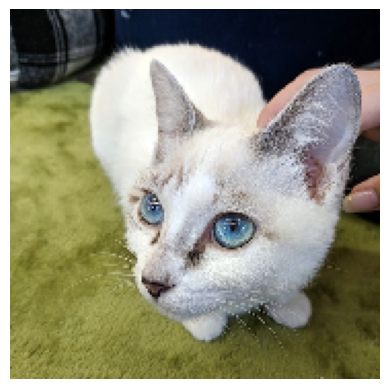

In [ ]:
# Get an image of a cat

img_path = keras.utils.get_file(fname='cat.jpg', origin='https://img-datasets.s3.amazonaws.com/cat.jpg')

def get_img_array(img_path, target_size):

    img = keras.utils.load_img(img_path, target_size=target_size)
    array = keras.utils.img_to_array(img)
    array = np.expand_dims(array, axis=0)

    return array

cat_tensor = get_img_array(img_path, target_size=(180, 180))
plt.axis('off')
plt.imshow(cat_tensor[0].astype(np.uint8))

In [ ]:
# Extracting output of each layer

layer_outputs = []
layer_names = []

for layer in model.layers:
    if isinstance(layer, (layers.Conv2D, layers.MaxPooling2D)):
        layer_outputs.append(layer.output)
        layer_names.append(layer.name)

activation_model = keras.Model(inputs=model.input, outputs=layer_outputs)

In [ ]:
activations = activation_model.predict(cat_tensor)

1/1 [==============================] - 0s 346ms/step


In [ ]:
for activation in activations:
    print(activation.shape)

(1, 178, 178, 32)
(1, 89, 89, 32)
(1, 87, 87, 64)
(1, 43, 43, 64)
(1, 41, 41, 128)
(1, 20, 20, 128)
(1, 18, 18, 256)
(1, 9, 9, 256)
(1, 7, 7, 256)


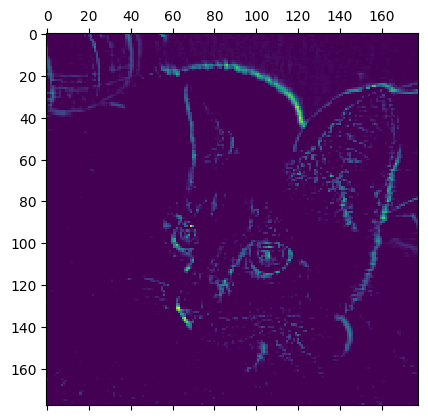

In [ ]:
# Plotting the 15th feature map of the first layer

plt.matshow(activations[0][0, :, :, 15])

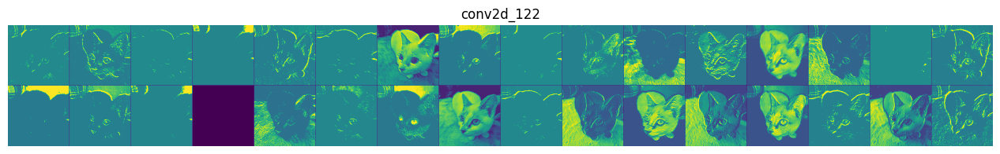

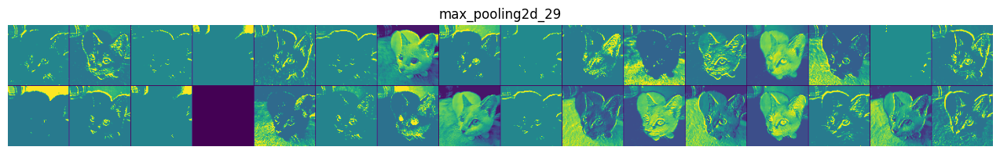

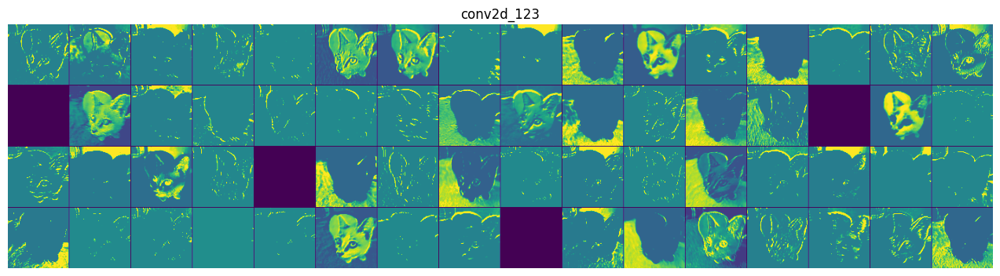

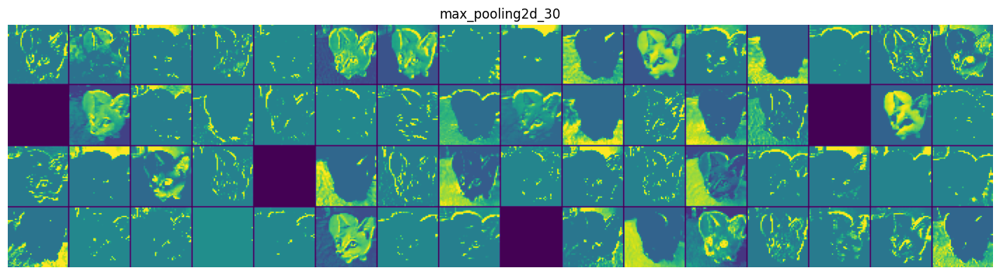

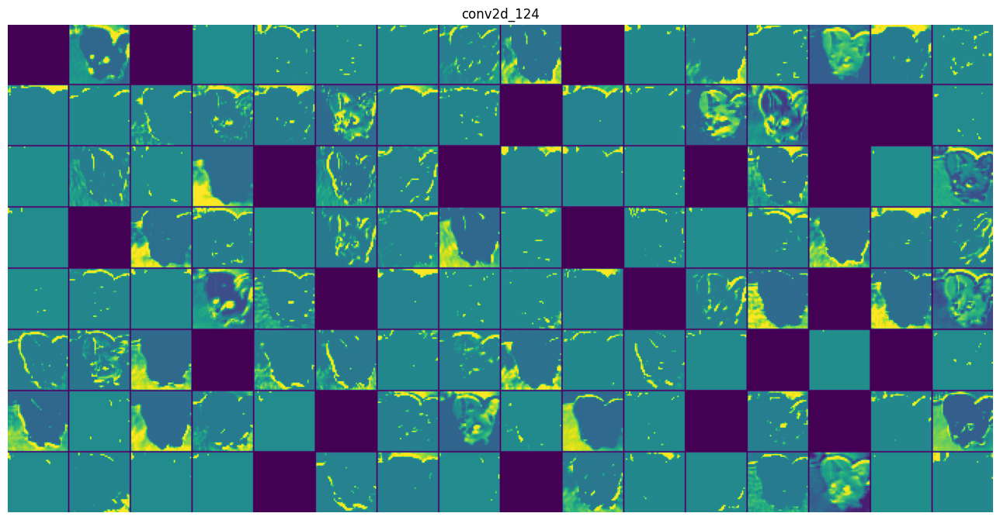

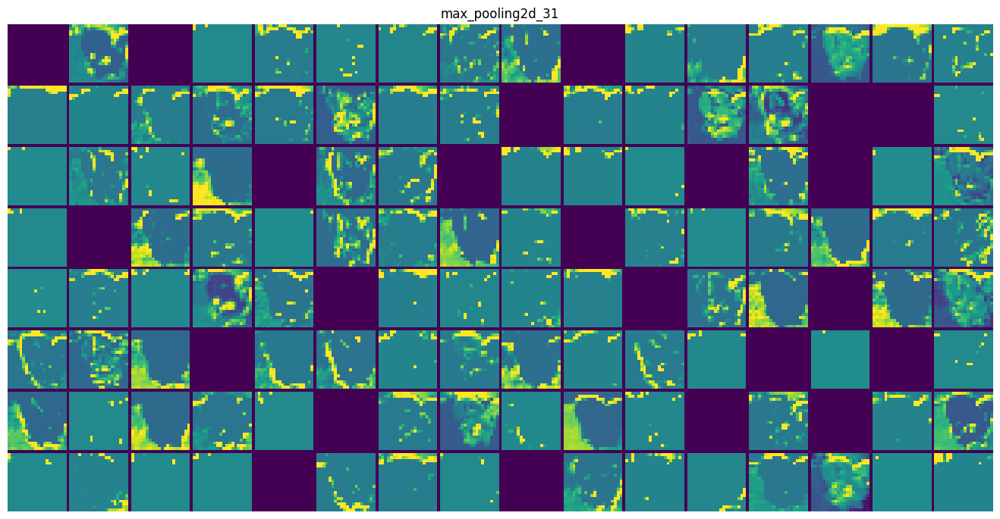

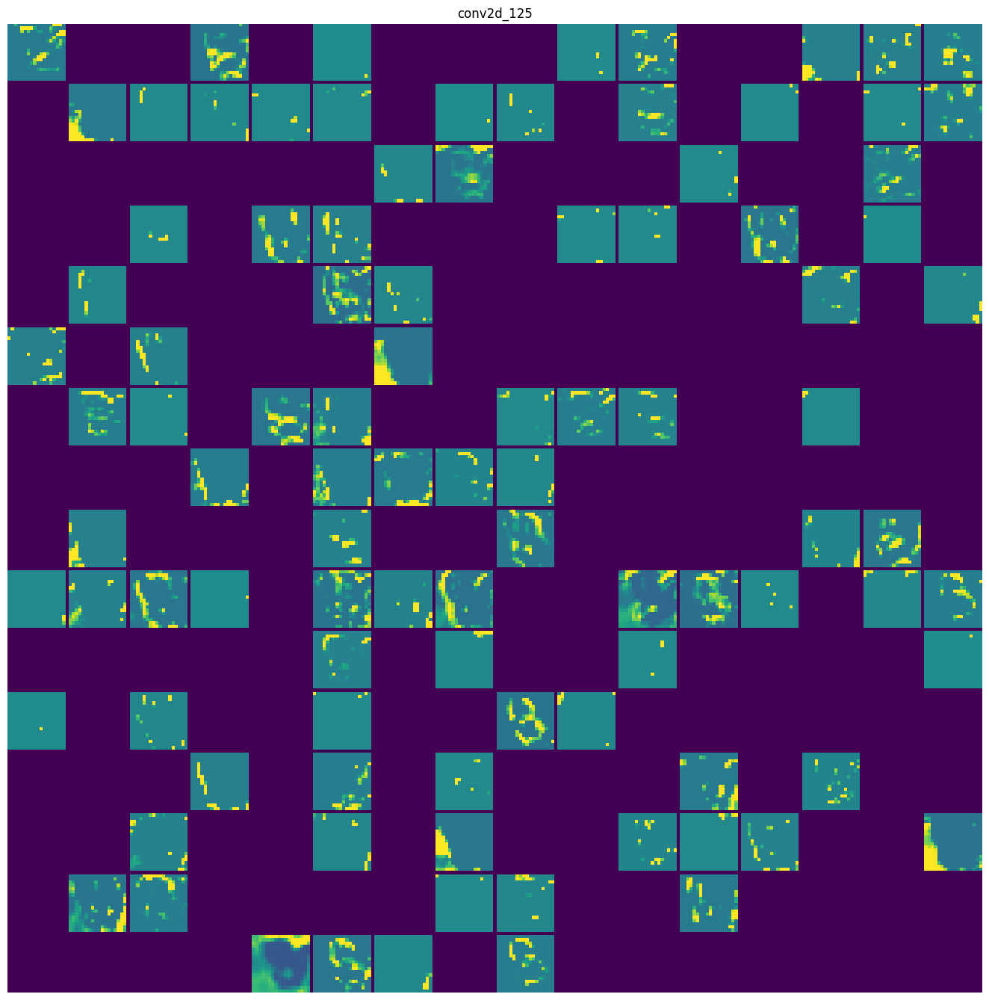

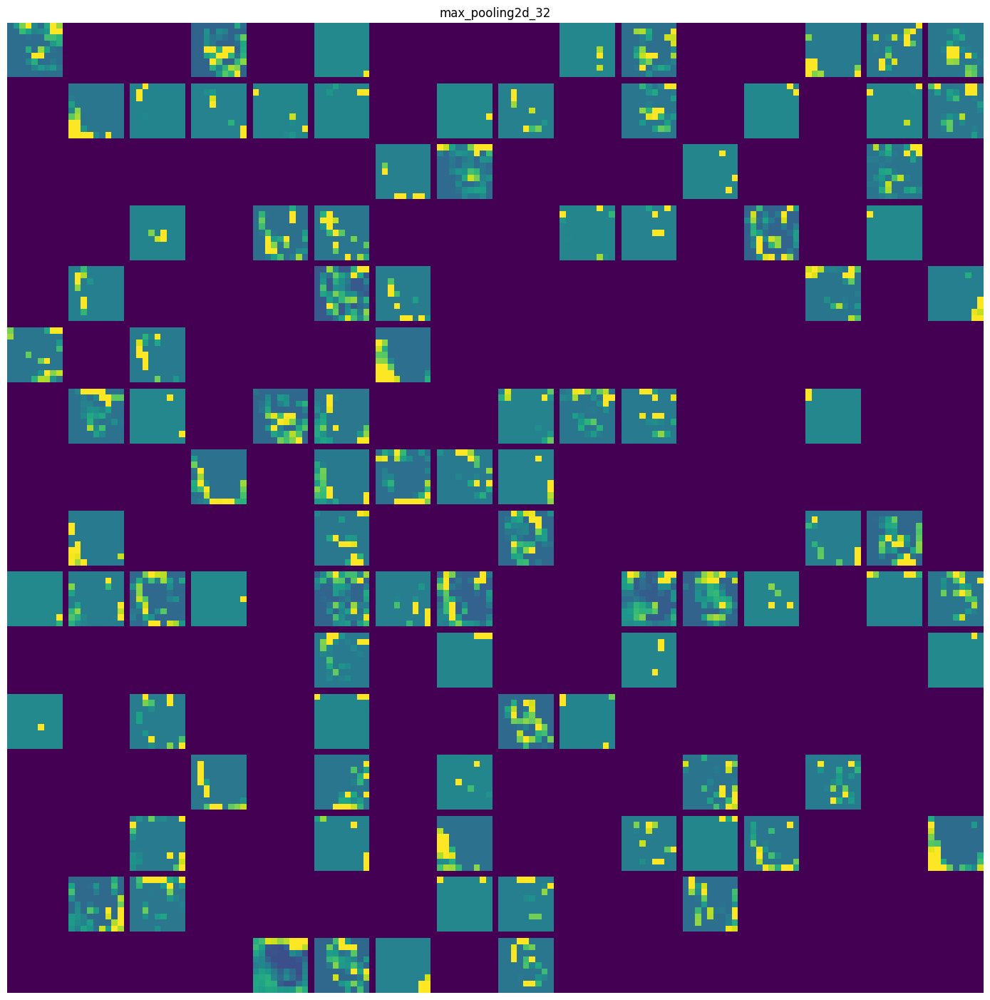

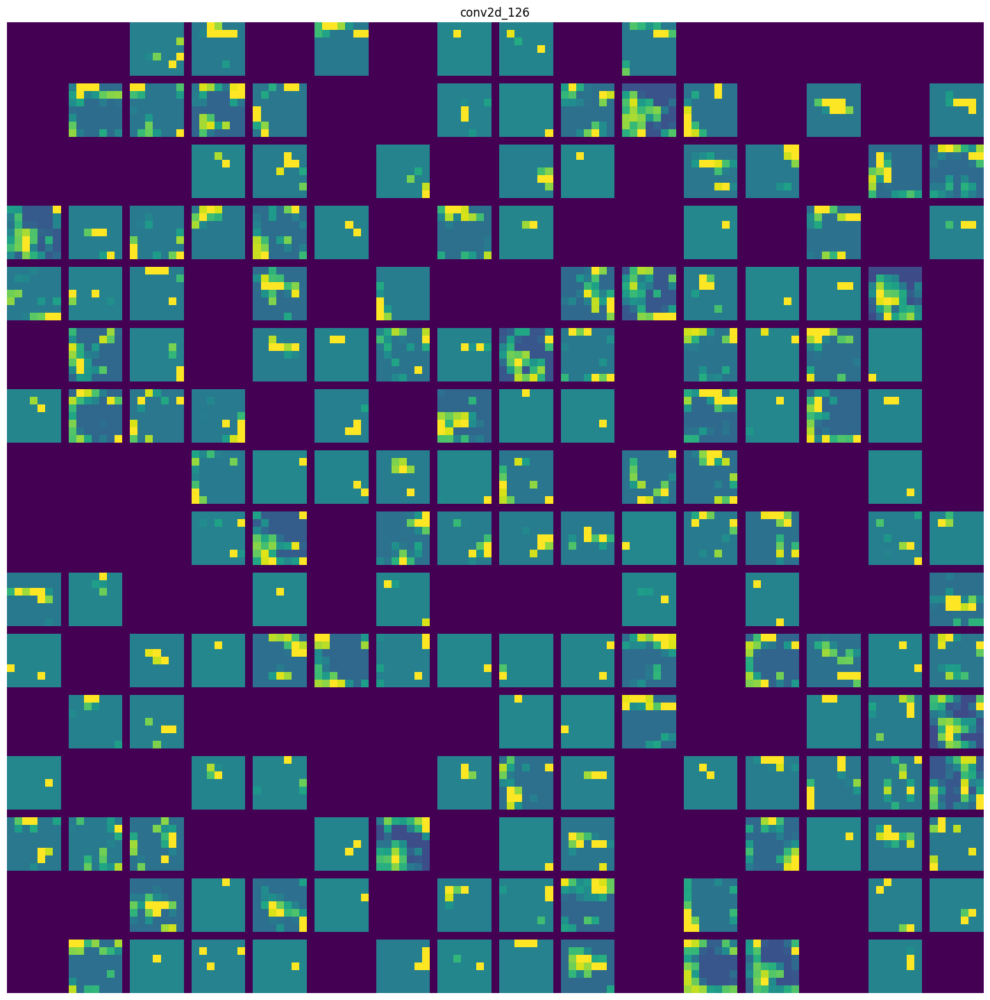

In [ ]:
# Plotting every channel in a grid
# Note how later layers have more and more missing activations. This is because the input image does not activate these channels of the trained model.

images_per_row = 16

for layer_name, layer_activation in zip(layer_names, activations):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_cols = n_features // images_per_row
    display_grid = np.zeros(((size + 1) * n_cols - 1, images_per_row * (size + 1) - 1))

    for col in range(n_cols):
        for row in range(images_per_row):
            channel_id = col * images_per_row + row
            channel_image = layer_activation[0, :, :, channel_id].copy()
            if channel_image.sum() != 0:
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype(np.uint8)
            display_grid[
                col * (size + 1) : (col + 1) * size + col,
                row * (size + 1) : (row + 1) * size + row] = channel_image
    
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.axis('off')
    plt.imshow(display_grid, aspect='auto')

## Visualizing ConvNet filters

In [ ]:
model = keras.applications.xception.Xception(weights='imagenet', include_top=False)

In [ ]:
for layer in model.layers:
    if isinstance(layer, (layers.Conv2D, layers.SeparableConv2D)):
        print(layer.name, layer.output_shape)

block1_conv1 (None, None, None, 32)
block1_conv2 (None, None, None, 64)
block2_sepconv1 (None, None, None, 128)
block2_sepconv2 (None, None, None, 128)
conv2d (None, None, None, 128)
block3_sepconv1 (None, None, None, 256)
block3_sepconv2 (None, None, None, 256)
conv2d_1 (None, None, None, 256)
block4_sepconv1 (None, None, None, 728)
block4_sepconv2 (None, None, None, 728)
conv2d_2 (None, None, None, 728)
block5_sepconv1 (None, None, None, 728)
block5_sepconv2 (None, None, None, 728)
block5_sepconv3 (None, None, None, 728)
block6_sepconv1 (None, None, None, 728)
block6_sepconv2 (None, None, None, 728)
block6_sepconv3 (None, None, None, 728)
block7_sepconv1 (None, None, None, 728)
block7_sepconv2 (None, None, None, 728)
block7_sepconv3 (None, None, None, 728)
block8_sepconv1 (None, None, None, 728)
block8_sepconv2 (None, None, None, 728)
block8_sepconv3 (None, None, None, 728)
block9_sepconv1 (None, None, None, 728)
block9_sepconv2 (None, None, None, 728)
block9_sepconv3 (None, None, No

In [ ]:
# Feature extractor model

layer_name = 'block7_sepconv3'
layer = model.get_layer(name=layer_name)
feature_extractor = keras.Model(inputs=model.input, outputs=layer.output)
activation = feature_extractor(keras.applications.xception.preprocess_input(cat_tensor))

activation.shape

TensorShape([1, 11, 11, 728])

In [ ]:
def compute_loss(image, filter_index, feature_extractor):
    
    activation = feature_extractor(image)
    filter_activation = activation[:, 2:-2, 2:-2, filter_index]          # We avoid border artifacts by only involving non-border pixels in the loss
    
    return tf.reduce_mean(filter_activation)

### Side Note: `model(x)` vs `model.predict(x)`

#### `model(x)` does not batch, compute happens in-memory. However, `model(x)` is differentiable.
#### `model.predict(x)` batches data (parameterized) and concatenates the outputs, easily scalable. However, `model.predict(x)` is not differentiable, and you can't retrieve gradients when called under a `tf.GradientTape` scope.

In [ ]:
@tf.function
def gradient_ascent_step(image, filter_index, learning_rate, feature_extractor):

    with tf.GradientTape() as tape:
        tape.watch(image)
        loss = compute_loss(image, filter_index, feature_extractor)
    
    gradients = tape.gradient(loss, image)
    gradients = tf.math.l2_normalize(gradients)
    image += learning_rate * gradients 

    return image

In [ ]:
def generate_filter_pattern(filter_index, feature_extractor):
    iterations = 30
    learning_rate = 10.
    img_width = 200
    img_height = 200
    image = tf.random.uniform(minval=0.4, maxval=0.6, shape=(1, img_width, img_height, 3))

    for i in range(iterations):
        image = gradient_ascent_step(image, filter_index, learning_rate, feature_extractor)
    
    return image[0].numpy()

In [ ]:
def deprocess_image(image):
    
    image -= image.mean()
    image /= image.std()
    image *= 64
    image += 128
    image = np.clip(image, 0, 255).astype(np.uint8)
    image = image[25:-25, 25:-25, :]

    return image

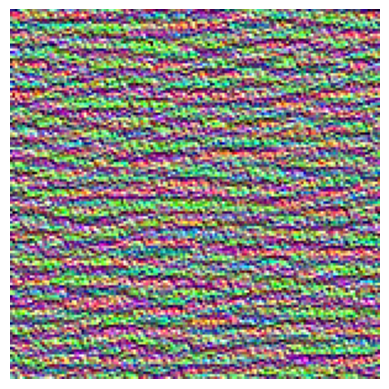

In [ ]:
plt.axis('off')
plt.imshow(deprocess_image(generate_filter_pattern(filter_index=2, feature_extractor=feature_extractor)))

In [ ]:
# Generate 64 filters in a layer

all_images = []

for filter_index in tqdm(range(64), desc='Processing filters'):
    image = deprocess_image(generate_filter_pattern(filter_index, feature_extractor))
    all_images.append(image)

# Prepare canvas

margin = 5.
n = 8
img_width = 200
img_height = 200
cropped_width = img_width - 25 * 2
cropped_height = img_height - 25 * 2
width = int(n * cropped_width + (n - 1) * margin)
height = int(n * cropped_height + (n - 1) * margin)
stitched_filters = np.zeros((width, height, 3))

# Fill canvas

for i in range(n):
    for j in range(n):
        image = all_images[i * n + j]

        row_start = int((cropped_width + margin) * i)
        row_end = int(row_start + cropped_width)
        col_start = int((cropped_height + margin) * j)
        col_end = int(col_start + cropped_height)
        stitched_filters[row_start : row_end,
                         col_start : col_end,
                         :] = image
        
keras.utils.save_img(f'./out/filters_for_layer{layer_name}.png', stitched_filters)

Processing filters:   0%|          | 0/64 [00:00<?, ?it/s]

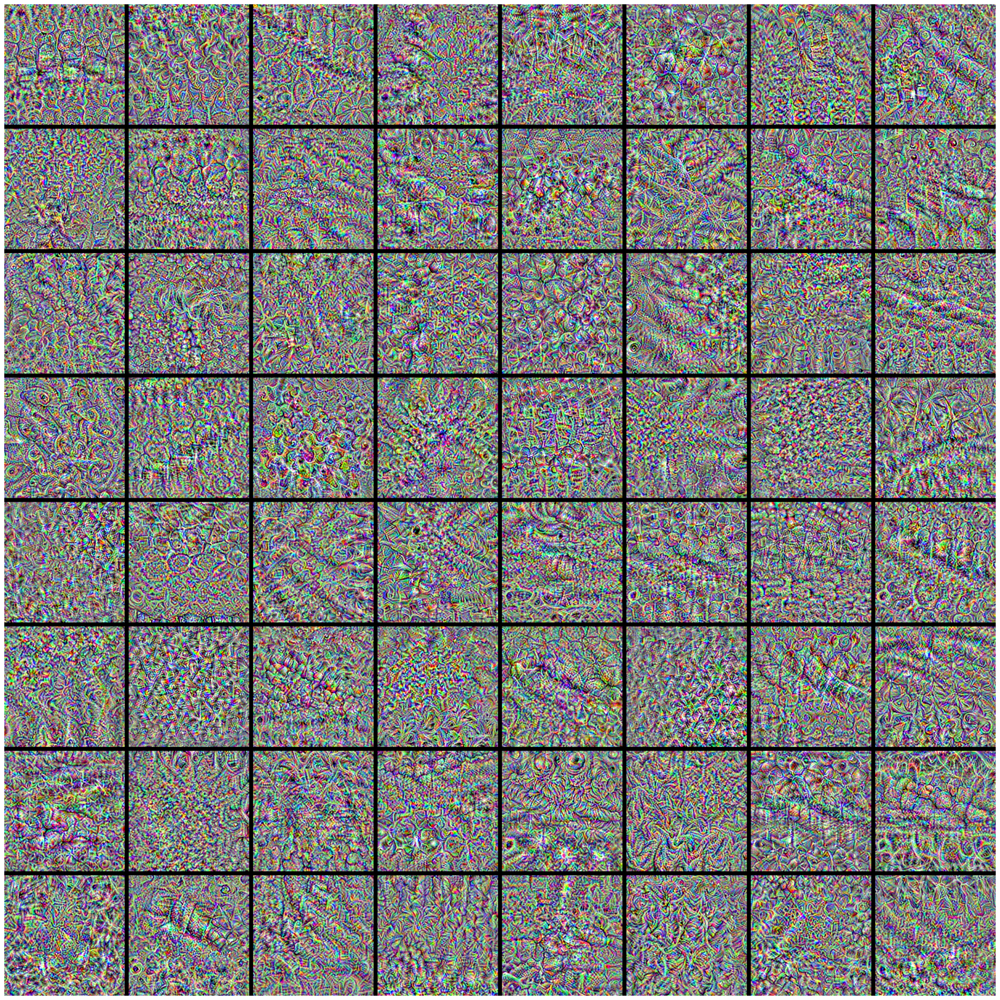

In [ ]:
plt.figure(figsize=(30,30))
plt.axis('off')
plt.imshow(stitched_filters.astype(np.uint8))

## CAM (Class Activation Map) visualization

In [ ]:
model = keras.applications.xception.Xception(weights='imagenet')

91884032/91884032 [==============================] - 13s 0us/step


PIL.Image.Image

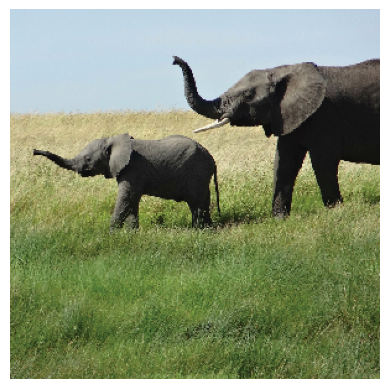

In [ ]:
elephant_image = keras.utils.load_img("./data/elephant.png", target_size=(299, 299))
plt.axis('off')
plt.imshow(elephant_image)
type(elephant_image)

In [ ]:
elephant_array = img_to_array(elephant_image)                       # Convert to np array
elephant_array = np.expand_dims(elephant_array, axis=0)                         # Batching (BHWC)
elephant_array = keras.applications.xception.preprocess_input(elephant_array)   # Xception preprocessing: channel-wise color normalization, among others

elephant_array.shape

(1, 299, 299, 3)

In [ ]:
preds = model.predict(elephant_array)
keras.applications.xception.decode_predictions(preds, top=3)[0]

1/1 [==============================] - 1s 710ms/step


[('n02504458', 'African_elephant', 0.9198523),
 ('n01871265', 'tusker', 0.037641037),
 ('n02504013', 'Indian_elephant', 0.012584575)]

In [ ]:
np.argmax(preds[0]) # Class index maximally activated (African_elephant)

386

In [ ]:
# Identify classifier layers and last conv layer

classifier_layer_names = []
last_conv_layer_name = None

for layer in model.layers[::-1]:
    if 'conv' in layer.name:
        last_conv_layer_name = layer.name 
        break
    classifier_layer_names.append(layer.name)

print(last_conv_layer_name)
classifier_layer_names.reverse()
print(classifier_layer_names)

last_conv_layer = model.get_layer(last_conv_layer_name)
last_conv_layer_model = keras.Model(model.inputs, last_conv_layer.output)

block14_sepconv2_act
['avg_pool', 'predictions']


In [ ]:
classifier_input = keras.Input(shape=last_conv_layer.output.shape[1:])
x = classifier_input

for layer_name in classifier_layer_names:
    x = model.get_layer(layer_name)(x)

classifier_model = keras.Model(classifier_input, x)

In [ ]:
# Compute the gradient of [top predicted class] with respect to [activations of last conv layer] for our input image

with tf.GradientTape() as tape:

    last_conv_layer_output = last_conv_layer_model(elephant_array)
    tape.watch(last_conv_layer_output)
    preds = classifier_model(last_conv_layer_output)
    top_pred_index = np.argmax(preds[0])
    top_class_channel = preds[:, top_pred_index]

grads = tape.gradient(top_class_channel, last_conv_layer_output)
grads.shape

TensorShape([1, 10, 10, 2048])

Pooled grads shape (2048,)
Last Conv layer outputs shape (10, 10, 2048)
Heatmap shape (10, 10)


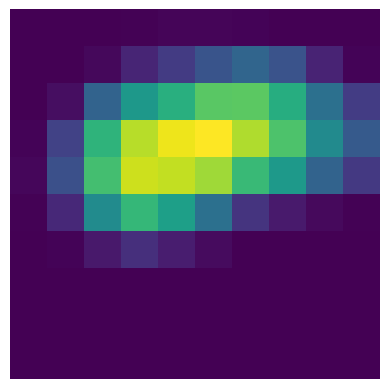

In [ ]:
# Mean intensity of the gradient for each channel. Quantifies importance of each channel with regard to the top predicted class.
pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2)).numpy()

print('Pooled grads shape', pooled_grads.shape)

# Convert last conv layer outputs to numpy
last_conv_layer_output_array = last_conv_layer_output.numpy()[0]

print('Last Conv layer outputs shape', last_conv_layer_output_array.shape)

# Weighting last conv layer outputs with "how important the channel is"
for i in range(pooled_grads.shape[-1]):
    last_conv_layer_output_array[:, :, i] *= pooled_grads[i]

# Mean of the activations across all channels, resulting in a H x W matrix
heatmap = np.mean(last_conv_layer_output_array, axis=-1)

print('Heatmap shape', heatmap.shape)

heatmap = np.maximum(heatmap, 0)
heatmap /= np.max(heatmap)
plt.axis('off')
plt.imshow(heatmap)

/var/folders/v8/l597fdmn691ctljk27sgct540000gn/T/ipykernel_82811/2584405597.py:8: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = cm.get_cmap('jet')


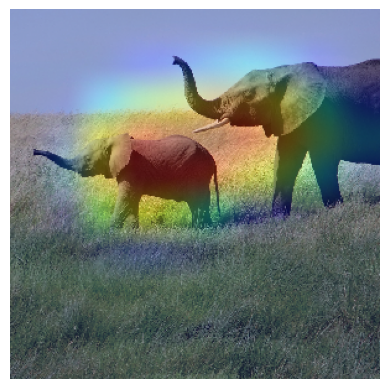

In [ ]:
# Let's generate an image that superimposes the original image on the heatmap

elephant_array = img_to_array(elephant_image)
e_heatmap = np.uint8(255 * heatmap)

jet = cm.get_cmap('jet')
jet_colors = jet(np.arange(256))[:, :3]
jet_heatmap = jet_colors[e_heatmap]

jet_heatmap = array_to_img(jet_heatmap)
jet_heatmap = jet_heatmap.resize((elephant_array.shape[1], elephant_array.shape[0]))
jet_heatmap = img_to_array(jet_heatmap)

jet_heatmap.shape

# Set opacity of heatmap to 40%
superimposed_img = jet_heatmap * 0.4 + elephant_array
superimposed_img = array_to_img(superimposed_img)

plt.axis('off')
plt.imshow(superimposed_img)

superimposed_img.save('out/elephant_cam.png')